In [50]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


In [51]:
csv_path='../data/dhs_clusters.csv'
df = pd.read_csv(csv_path, float_precision='high', index_col=False)
REQUIRED_BANDS = [
    'BLUE', 'GREEN', 'LAT', 'LON', 'NIGHTLIGHTS', 'NIR', 'RED',
    'SWIR1', 'SWIR2', 'TEMP1']


In [52]:
!pwd

/home/saori/code/saoriyosano/poverty_mapper/model


In [53]:
sample_image = "../data/dhs_tfrecords/angola_2011/00000.tfrecord.gz"

In [54]:
options = tf.io.TFRecordOptions(tf.io.TFRecordCompressionType.GZIP)

In [56]:
items = list(df.columns)
items.remove('GID_1')
items.remove('GID_2')

In [57]:
items

['country', 'year', 'lat', 'lon', 'wealthpooled', 'households', 'urban_rural']

In [58]:
iterator = tf.io.tf_record_iterator(sample_image, options=options)

In [59]:
for record_str in iterator:
    ex = tf.train.Example.FromString(record_str)
    feature_map = ex.features.feature

In [72]:
feature_map

{'LON': float_list {
  value: 13.50073528289795
  value: 13.501005172729492
  value: 13.501274108886719
  value: 13.501543998718262
  value: 13.501813888549805
  value: 13.502082824707031
  value: 13.502352714538574
  value: 13.5026216506958
  value: 13.502891540527344
  value: 13.50316047668457
  value: 13.503430366516113
  value: 13.503700256347656
  value: 13.503969192504883
  value: 13.504239082336426
  value: 13.504508018493652
  value: 13.504777908325195
  value: 13.505047798156738
  value: 13.505316734313965
  value: 13.505586624145508
  value: 13.505855560302734
  value: 13.506125450134277
  value: 13.50639533996582
  value: 13.506664276123047
  value: 13.50693416595459
  value: 13.507203102111816
  value: 13.50747299194336
  value: 13.507741928100586
  value: 13.508011817932129
  value: 13.508281707763672
  value: 13.508550643920898
  value: 13.508820533752441
  value: 13.509089469909668
  value: 13.509359359741211
  value: 13.509629249572754
  value: 13.50989818572998
  value

In [78]:
bands_feature = {}
bands_values = {}

for band in REQUIRED_BANDS:
    if band == 'LAT':
        lat = feature_map[band].__getattribute__('float_list').value[0]
    if band == 'LON':
        lon = feature_map[band].__getattribute__('float_list').value[0]
    bands_feature[band] = feature_map[band]
    bands_values[band] = np.reshape(
        np.array(
            bands_feature[band].__getattribute__('float_list').value
            ), (255, 255)
    )


In [63]:
bands_values

{'BLUE': array([[0.04875   , 0.04905   , 0.04985   , ..., 0.16875   , 0.1645    ,
         0.15925001],
        [0.0479    , 0.04845   , 0.051     , ..., 0.16769999, 0.1619    ,
         0.1608    ],
        [0.0495    , 0.05125   , 0.05075   , ..., 0.1646    , 0.14650001,
         0.1446    ],
        ...,
        [0.04145   , 0.03915   , 0.04315   , ..., 0.045     , 0.046     ,
         0.04505   ],
        [0.045     , 0.0416    , 0.04145   , ..., 0.0479    , 0.0458    ,
         0.04515   ],
        [0.04445   , 0.04475   , 0.0446    , ..., 0.0442    , 0.0454    ,
         0.04685   ]]),
 'GREEN': array([[0.05215   , 0.05215   , 0.05115   , ..., 0.25674999, 0.25854999,
         0.25385001],
        [0.05215   , 0.05195   , 0.0531    , ..., 0.25870001, 0.25389999,
         0.2568    ],
        [0.0534    , 0.0535    , 0.0555    , ..., 0.25850001, 0.23549999,
         0.22679999],
        ...,
        [0.03765   , 0.03765   , 0.03805   , ..., 0.04445   , 0.047     ,
         0.04545 

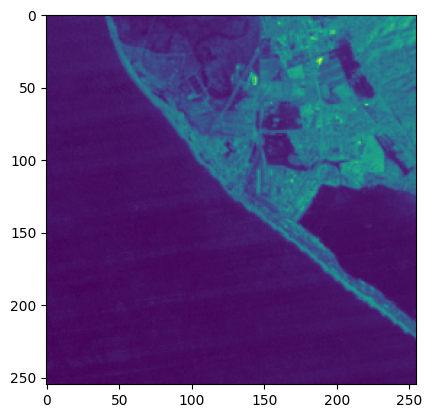

In [64]:
plt.imshow(bands_values['BLUE'])

In [66]:
image_stacked = np.dstack((
    bands_values['RED'],
    bands_values['GREEN'],
    bands_values['BLUE'],
    bands_values['NIR'],
    bands_values['SWIR1'],
    bands_values['SWIR2'],
    bands_values['TEMP1'],
    ))

In [68]:
image_stacked.shape

(255, 255, 7)

In [69]:
df

,country,year,lat,lon,GID_1,GID_2,wealthpooled,households,urban_rural
0,angola,2011,-12.350257,13.534922,AGO.2,AGO.2.9,2.595618,36,1
1,angola,2011,-12.360865,13.551494,AGO.2,AGO.2.9,2.209620,32,1
2,angola,2011,-12.613421,13.413085,AGO.2,AGO.2.3,0.906469,36,1
3,angola,2011,-12.581454,13.397711,AGO.2,AGO.2.3,1.105359,35,1
4,angola,2011,-12.578135,13.418748,AGO.2,AGO.2.3,1.879344,37,1
...,...,...,...,...,...,...,...,...,...
19664,zimbabwe,2015,-17.915288,31.156115,ZWE.2,ZWE.2.1,0.237659,24,1
19665,zimbabwe,2015,-18.379501,31.872287,ZWE.3,ZWE.3.4,0.492502,25,0
19666,zimbabwe,2015,-16.660612,29.850649,ZWE.6,ZWE.6.2,-0.088922,28,0
19667,zimbabwe,2015,-17.914251,30.956975,ZWE.2,ZWE.2.1,1.613829,25,1


In [84]:
df #[(df.lat == lat) & (df.lon == lon)]

,country,year,lat,lon,GID_1,GID_2,wealthpooled,households,urban_rural
